# PCA Homework

2021.4.13

**本次作业将在MNIST手写数字数据集上实现PCA降维及聚类** 
  


⭐ **train_X.csv**: 存放了mnist数据集的data结果，若下载太慢可直接导入


⭐ **train_y.csv**: 存放了mnist数据集的target结果，若下载太慢可直接导入


### 1.通过**sklearn**库下载mnist数据集

可以通过`conda install scikit-learn`安装该库

In [1]:
import sklearn
from sklearn.datasets import fetch_openml
import numpy as np
import pandas as pd

# mnist=fetch_openml('mnist_784',version=1,cache=True)
X = pd.read_csv('./train_X.csv')
y = pd.read_csv('./train_y.csv')

X = np.array(X)
y = np.array(y)

X = X[:6000, :] # 取前6000个样本
y = y[:6000]
y = np.squeeze(y)

(X.shape, y.shape)

((6000, 784), (6000,))

### 2.对mnist数据集进行PCA降维
可以通过调用`sklearn`库的函数实现，也可以自己实现PCA操作

In [2]:
## TODO
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing
X=preprocessing.scale(X)
pca=PCA()
pca.fit(X)
X_pca=pca.transform(X)


In [3]:
X_pca.shape

(6000, 784)

### 3.画出前12个特征向量所对应的(28, 28)维度的特征图像。
*（提示：将PCA降维后的特征向量转回原始图像的shape来显示）*

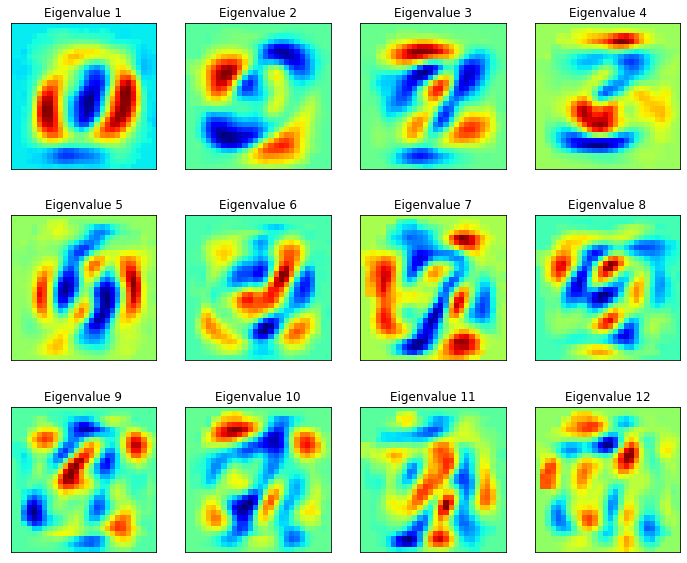

In [4]:
## TODO
import matplotlib.pyplot as plt
from matplotlib.colors import Colormap
eigenvalues=pca.components_
plt.figure(figsize=(12,10))
for i in range(12):
    plt.subplot(3,4,i+1)
    plt.imshow(eigenvalues[i].reshape(28,28),cmap='jet')
    plt.title('Eigenvalue '+str(i+1))
    plt.xticks(())
    plt.yticks(())
plt.show()

### 4.使用PCA降维到2维，绘制散点图，颜色是它们相应的真实label
散点图和序号标记可以参考[blog](https://blog.csdn.net/weixin_40198632/article/details/78455886)，可以考虑同类别数据点每50个标记一次，不用每个都标记

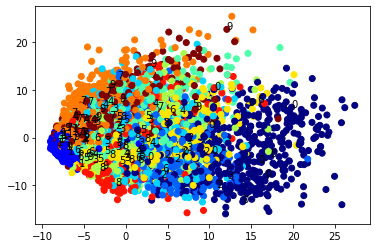

In [9]:
## TODO
X_2d=X_pca[:,:2]
fig,ax=plt.subplots()
ax.scatter(X_2d[:,0],X_2d[:,1],c=y,cmap='jet')
y_count=dict((i,0) for i in range(10))
for i in range(6000):
    y_count[y[i]]+=1
    if(y_count[y[i]]%50==0):
        ax.annotate(y[i],X_2d[i])

### 5.将数据通过PCA方法降到2维，使用kmeans方法对其进行聚类，绘制聚类后的分类图
聚类为3类，绘制分类图观察结果并计算[ARI](https://sklearn.org/modules/generated/sklearn.metrics.adjusted_rand_score.html#sklearn.metrics.adjusted_rand_score)（调整兰德指数），使用`sklearn.metrics.adjusted_rand_score()`函数可计算该指数

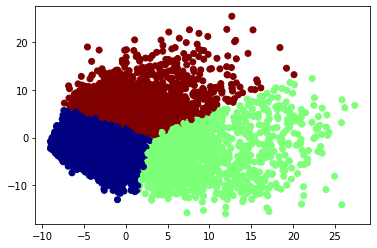

0.06568206509202973

In [6]:
## TODO
from sklearn.cluster import KMeans
X_2d_K3=KMeans(n_clusters=3,init='k-means++').fit(X_2d)
fig,ax=plt.subplots()
ax.scatter(X_2d[:,0],X_2d[:,1],c=X_2d_K3.labels_,cmap='jet')
plt.show()
from sklearn.metrics import adjusted_rand_score
adjusted_rand_score(y,X_2d_K3.labels_)

取类别数从3至20（可以自行扩展），根据ARI找到最佳的聚类结果，并绘制分类图

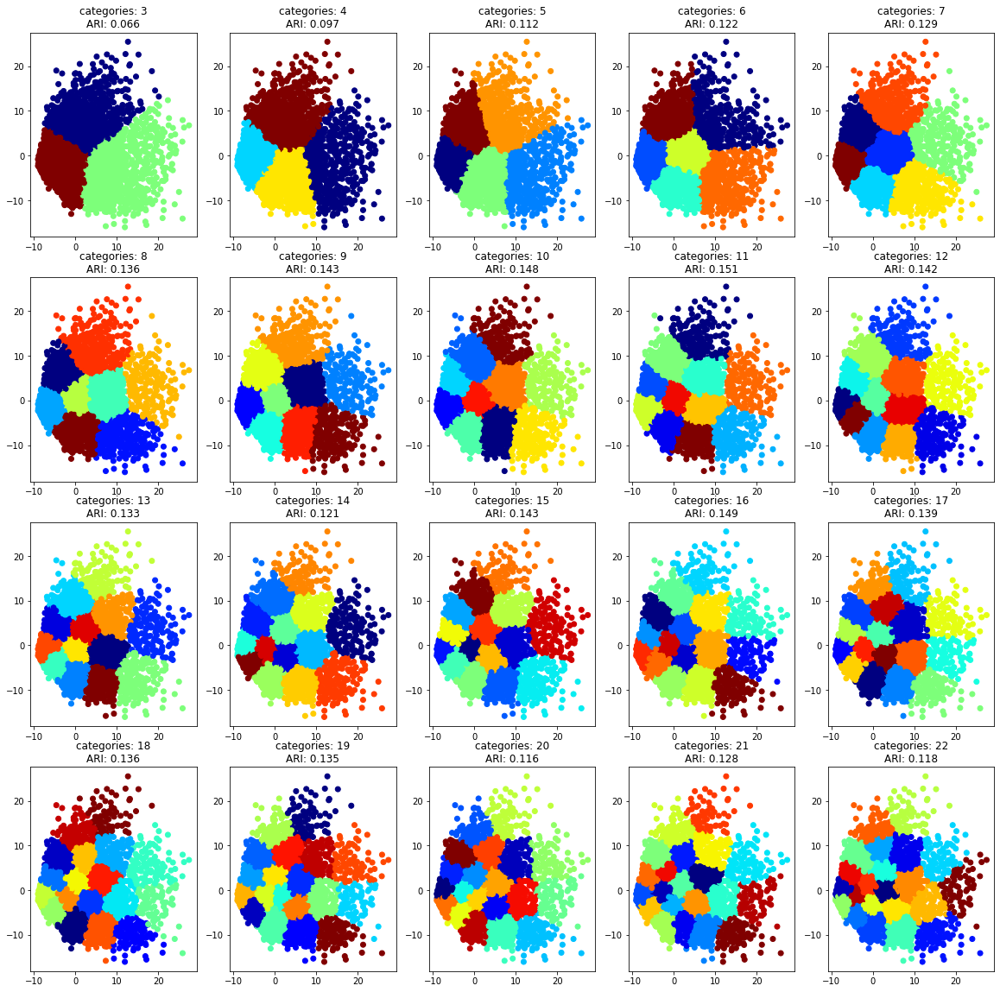

In [8]:
## TODO
Kmeans_3_20=[KMeans(n_clusters=i,init='k-means++').fit(X_2d) for i in range(3,23)]
ARI_3_20=[adjusted_rand_score(y,Kmeans_3_20[i-3].labels_) for i in range(3,23)]
plt.figure(figsize=(20,20))
for i in range(20):
    plt.subplot(4,5,i+1)
    plt.scatter(X_2d[:,0],X_2d[:,1],c=Kmeans_3_20[i].labels_,cmap='jet')
    plt.title("categories: "+str(i+3)+"\nARI: %.3f"%ARI_3_20[i])
plt.show()